# Examining Transit Use and the FEMA National Heat Wave Risk Index of Two LA County Neighborhoods in 2022

## Maxwell Kilman

In [Week 3](https://jupyter.idre.ucla.edu/user/mtk@g.ucla.edu/lab/tree/up221-max/Week03/week3assignment.ipynb), I identified the five census tracts in Los Angeles County with the highest percentage of transit users in both 2010 and 2022. This week, I will build on that exploration by identifying tracts in neighboring Echo Park. I will determine each of these additional tract's percentage of transit users in 2022. Next, I will create a graduated color map that represents these differences in transit use. Then, I will overlay this map with data on heat wave risk as quantified in the [FEMA National Risk Index](https://hazards.fema.gov/nri/data-resources). In addition, I will use modules like `plotly` to create more compelling charts representing the potential relationships between high/low transit-use areas and high/low heat risk areas. 

### Importing Necessary Modules 

In [2]:
# pandas as pd
import pandas as pd

# geopandas for shapefiles as gpd
import geopandas as gpd

# folium for mapping
import folium 

# plotly for interactive plots
import plotly.express as px

# matplot as plt and contextily as ctx 

import matplotlib.pyplot as plt

import contextily as ctx

Now that I have imported all of the modules I will use in preparing my datasets and data visualizations, I can move on to import the data I will work with. Given that this assignment is an expansion of Week 3, I will rely on a similar process of cleaning and prepping the ACS data as I previously employed. However, I will need to complete additional work to prepare the FEMA dataset I have not used before.  

### Importing and Cleaning Datasets

In [3]:
# importing 2022 ACS datasets
ACS_22 = pd.read_csv('Data/ACS_22C.csv')

As noted in my previous assignment, python dropped the leading zeros in the column `GEO_ID`, so I will use the `dtype` command to convert `GEO_ID` to a `str` or `object`

In [4]:
# converting GEO_ID to a string for 22
ACS_22C = pd.read_csv(
    'Data/ACS_22C.csv',
    dtype=
    {
        'GEO_ID':str
    }
)

We can verify that the `dtype` command resolved the issue with leading zeros:

In [5]:
# .head to check leading zeros in 2022 data again
ACS_22.GEO_ID.head()

0    6037101110
1    6037101122
2    6037101220
3    6037101221
4    6037101222
Name: GEO_ID, dtype: int64

Success! Now, we can proceed. Granted that I have already worked with this dataset, I do not need to make sure it does not have null or missing values. That said, let's go ahead and check once more.

In [6]:
# verifying non-null values/missing values/type with ACS 22
ACS_22C.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2498 entries, 0 to 2497
Data columns (total 44 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   GEO_ID       2498 non-null   object
 1   NAME         2498 non-null   object
 2   B08301_001E  2498 non-null   int64 
 3   B08301_001M  2498 non-null   int64 
 4   B08301_002E  2498 non-null   int64 
 5   B08301_002M  2498 non-null   int64 
 6   B08301_003E  2498 non-null   int64 
 7   B08301_003M  2498 non-null   int64 
 8   B08301_004E  2498 non-null   int64 
 9   B08301_004M  2498 non-null   int64 
 10  B08301_005E  2498 non-null   int64 
 11  B08301_005M  2498 non-null   int64 
 12  B08301_006E  2498 non-null   int64 
 13  B08301_006M  2498 non-null   int64 
 14  B08301_007E  2498 non-null   int64 
 15  B08301_007M  2498 non-null   int64 
 16  B08301_008E  2498 non-null   int64 
 17  B08301_008M  2498 non-null   int64 
 18  B08301_009E  2498 non-null   int64 
 19  B08301_009M  2498 non-null 

Next, I will want to recreate the subset of my data. Once again, I'm interested in the `GEO_ID` column as well as the column for the total counts of public transportation use excluding taxicab (column `B08301_010E`). That said, it is also necessary to include the overall total of commuters for each census tract (`B08301_001E`). The total number of commuters will allow me to scale the count of public transportation users by census tract. I will add a column to my reduced dataframe that lists the transportation users as a percentage of the total commuters. First, we can reduce and review the dataframe.

In [7]:
# reducing the dataframe for ACS 22
columns_to_keep = ['GEO_ID',
                   'B08301_010E',
                   'B08301_001E'
                  ]
ACS_22Cb = ACS_22C[columns_to_keep]

# Reviewing the reduced dataframe
ACS_22Cb.head()

,GEO_ID,B08301_010E,B08301_001E
0,06037101110,49,2043
1,06037101122,9,2014
2,06037101220,91,1665
3,06037101221,47,1762
4,06037101222,19,1105


Now I'll go ahead and add the percentage transit users column that scales the number of transit users in each census tract with the total number of commuters. This allows me to accurately compare transit use between tracts with differing populations. 

In [8]:
# adding percentage transit for 2022
ACS_22Cb['transit_pct'] = (ACS_22Cb['B08301_010E'] / ACS_22Cb['B08301_001E']) * 100
# Verifying results of this column addition
ACS_22Cb.sample(5)

/tmp/ipykernel_543/854486539.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ACS_22Cb['transit_pct'] = (ACS_22Cb['B08301_010E'] / ACS_22Cb['B08301_001E']) * 100


,GEO_ID,B08301_010E,B08301_001E,transit_pct
208,06037124103,114,919,12.404788
773,06037226002,145,1168,12.414384
1567,06037482600,24,3056,0.785340
1727,06037534403,39,1063,3.668862
1716,06037533901,86,2278,3.775241


Once again, I'll relabel my columns. 

In [9]:
# changing column names ACS 22
ACS_22Cb.columns = ['FIPS',
'Total Transit Users (excluding taxicabs)',                 
'Total Commuters', 
'Percent Transit Users'
                  ]
# Reviewing column label changes 
ACS_22Cb.head()

,FIPS,Total Transit Users (excluding taxicabs),Total Commuters,Percent Transit Users
0,06037101110,49,2043,2.398434
1,06037101122,9,2014,0.446872
2,06037101220,91,1665,5.465465
3,06037101221,47,1762,2.667423
4,06037101222,19,1105,1.719457


Now, I will sort my dataframe by `Percent Transit Users` in descending order, using an index based on the magnitude of the percentage values

In [10]:
# indexing based on percent transit users and sorting by rank 
ACS_22Cb['Rank'] = ACS_22Cb['Percent Transit Users'].rank(ascending = 0) 
ACS_22Cb = ACS_22Cb.set_index('Rank') 
ACS_22Cb = ACS_22Cb.sort_index() 
ACS_22Cb.head()

/tmp/ipykernel_543/3758106370.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ACS_22Cb['Rank'] = ACS_22Cb['Percent Transit Users'].rank(ascending = 0)


,FIPS,Total Transit Users (excluding taxicabs),Total Commuters,Percent Transit Users
Rank,,,,
1.0,06037209402,1280,2234,57.296329
2.0,06037208903,1151,2018,57.036670
3.0,06037206303,205,396,51.767677
4.0,06037206302,161,355,45.352113
5.0,06037209401,796,1761,45.201590


Granted that several census tracts in LA County have no population and zero transit users, I will eliminate the null values in my `Percent Transit Users` column to tidy up the dataframe and more easily identify the tracts with the smallest percentage of transit users. 

In [11]:
# filtering for only values that are not NaN
ACS_22Cbb = ACS_22Cb[ACS_22Cb['Percent Transit Users'].notnull()]

Now, if I look to the tail of this ranked dataframe, I can identify the five tracts with the smallest percentage of transit users.

In [12]:
# lowest five tracts using .tail(5)
ACS_22Cbb.tail(5)

,FIPS,Total Transit Users (excluding taxicabs),Total Commuters,Percent Transit Users
Rank,,,,
2333.0,06037143101,0,1012,0.0
2333.0,06037143401,0,3105,0.0
2333.0,06037143402,0,996,0.0
2333.0,06037139703,0,895,0.0
2333.0,06037980036,0,300,0.0


A simple internet search reveals that these lie in the Valley. However, for our project, we will instead focus on tracts neighboring the Westlake-MacArthur Park area, namely Silverlake-Echo Park. 

### Importing and Merging ACS Dataframe with a Census Tract Geojson File

In [13]:
# importing corresponding geojson data using gpd
tracts=gpd.read_file('Data/Census_Tracts_20202.geojson')
tracts.head()

,OBJECTID,CT20,LABEL,ShapeSTArea,ShapeSTLength,geometry
0,1,101110,1011.10,1.229562e+07,15083.854287,"POLYGON ((-118.28491 34.25948, -118.28492 34.2..."
1,2,101122,1011.22,2.845774e+07,31671.455844,"POLYGON ((-118.29015 34.27417, -118.29015 34.2..."
2,3,101220,1012.20,7.522093e+06,12698.783810,"POLYGON ((-118.28100 34.25592, -118.28198 34.2..."
3,4,101221,1012.21,3.812000e+06,9161.710543,"POLYGON ((-118.28735 34.25591, -118.28863 34.2..."
4,5,101222,1012.22,3.191371e+06,9980.600461,"POLYGON ((-118.28594 34.25405, -118.28594 34.2..."


Now, we can `merge` our dataframes at the `FIPS` column to add a `geometry` column. 

First, we must create a `FIPS` column in the Geojson dataframe.

In [14]:
# subsetting data and editing to create a FIPS column
tracts = tracts[['CT20','geometry']]
tracts['FIPS'] ='06' + '037' + tracts['CT20']
tracts.head()

,CT20,geometry,FIPS
0,101110,"POLYGON ((-118.28491 34.25948, -118.28492 34.2...",06037101110
1,101122,"POLYGON ((-118.29015 34.27417, -118.29015 34.2...",06037101122
2,101220,"POLYGON ((-118.28100 34.25592, -118.28198 34.2...",06037101220
3,101221,"POLYGON ((-118.28735 34.25591, -118.28863 34.2...",06037101221
4,101222,"POLYGON ((-118.28594 34.25405, -118.28594 34.2...",06037101222


Now, we can proceed with the `.merge()` command

In [15]:
# merging at FIPS
tracts_transit22b=tracts.merge(ACS_22Cbb,on="FIPS")
tracts_transit22b.head()

,CT20,geometry,FIPS,Total Transit Users (excluding taxicabs),Total Commuters,Percent Transit Users
0,101110,"POLYGON ((-118.28491 34.25948, -118.28492 34.2...",06037101110,49,2043,2.398434
1,101122,"POLYGON ((-118.29015 34.27417, -118.29015 34.2...",06037101122,9,2014,0.446872
2,101220,"POLYGON ((-118.28100 34.25592, -118.28198 34.2...",06037101220,91,1665,5.465465
3,101221,"POLYGON ((-118.28735 34.25591, -118.28863 34.2...",06037101221,47,1762,2.667423
4,101222,"POLYGON ((-118.28594 34.25405, -118.28594 34.2...",06037101222,19,1105,1.719457


With this successful merge, we can now continue by assigning neighborhood labels to specific census tracts.

### Importing and Employing the Neighborhood Geojson File

Granted that our project focuses on Westlake-MacArthur Park census tracts with the highest percentage of transit users (tracts 06037209402, 06037208903, 06037209401) and tracts in Silverlake-Echo Park, I will import the `neighborhood` geojson data to assign neighborhood labels to census tracts in the cleaned ACS 2022 dataframe.

In [16]:
# importing neighborhoods geojson
neighborhoods = gpd.read_file("https://services5.arcgis.com/7nsPwEMP38bSkCjy/arcgis/rest/services/LA_Times_Neighborhoods/FeatureServer/0/query?outFields=*&where=1%3D1&f=geojson")

Now, I will use the `.sjoin()` command to link the ACS dataframe and the neighborhood geojson file 

In [17]:
# creating an appropriate geodataframe to join
tracts_transit22b = gpd.GeoDataFrame(
   tracts_transit22b,geometry = 'geometry', crs=4326)

In [18]:
# spatial join to merge transit acs data and neighborhood names 
transit_by_neighborhood = gpd.sjoin(neighborhoods, tracts_transit22b) 
transit_by_neighborhood

,OBJECTID,name,geometry,index_right,CT20,FIPS,Total Transit Users (excluding taxicabs),Total Commuters,Percent Transit Users
0,1,Adams-Normandie,"POLYGON ((-118.30069 34.03731, -118.30388 34.0...",760,222600,06037222600,227,2376,9.553872
31,32,Exposition Park,"POLYGON ((-118.29155 34.01837, -118.28294 34.0...",760,222600,06037222600,227,2376,9.553872
93,94,University Park,"POLYGON ((-118.27986 34.01848, -118.28294 34.0...",760,222600,06037222600,227,2376,9.553872
0,1,Adams-Normandie,"POLYGON ((-118.30069 34.03731, -118.30388 34.0...",757,222100,06037222100,329,1907,17.252229
31,32,Exposition Park,"POLYGON ((-118.29155 34.01837, -118.28294 34.0...",757,222100,06037222100,329,1907,17.252229
...,...,...,...,...,...,...,...,...,...
112,113,Woodland Hills,"POLYGON ((-118.57240 34.18668, -118.57161 34.1...",334,137202,06037137202,22,1687,1.304090
112,113,Woodland Hills,"POLYGON ((-118.57240 34.18668, -118.57161 34.1...",333,137104,06037137104,0,1091,0.000000
112,113,Woodland Hills,"POLYGON ((-118.57240 34.18668, -118.57161 34.1...",332,137103,06037137103,137,2780,4.928058
112,113,Woodland Hills,"POLYGON ((-118.57240 34.18668, -118.57161 34.1...",336,137301,06037137301,9,1106,0.813743


Now that the dataframes are joined, I will use `plotly` to produce a graduated color map that uses color to represent the percentages of transit use in each neighborhood. 

In [19]:
gdf21 = transit_by_neighborhood.to_crs(epsg=3857)

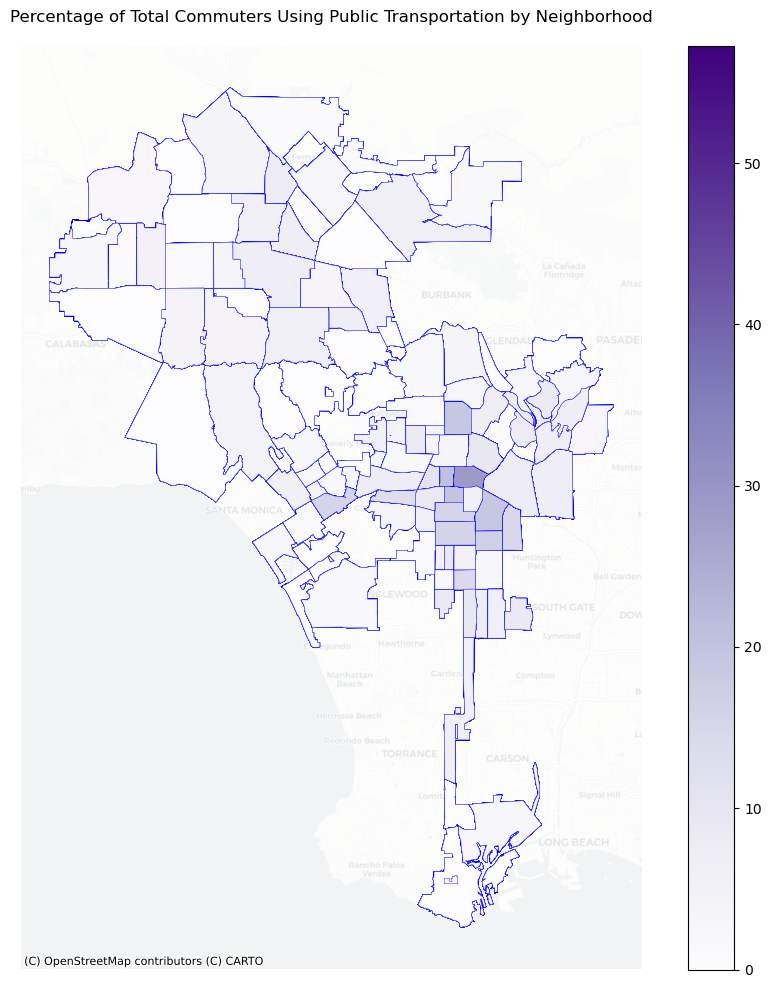

In [21]:
# choropleth map of percent transit users by neighborhoods
fig, ax = plt.subplots(figsize=(12, 12))
gdf21.plot(ax=ax, column='Percent Transit Users', legend=True, cmap='Purples', edgecolor='b', linewidth=0.3)
ax.set_title('Percentage of Total Commuters Using Public Transportation by Neighborhood')
ax.axis('off');

ctx.add_basemap(ax=ax,
                source=ctx.providers.CartoDB.Positron,
                alpha=0.3 # add transparency to make it less dominant
                )
plt.show()
fig.savefig('Transit.png')

We can easily identify the Westlake neighborhood in dark blue, as we know from our census data that the highest percentage of transit users reside in tracts within that area.

In [22]:
# changing column names for the purpose of using mapbox
transit_by_neighborhood.columns = ['OBJECTID', 'Neighborhood', 'geometry', 'index_right','CT20', 'FIPS', 
'Total Transit Users (excluding taxicabs)',                 
'Total Commuters', 
'Percent Transit Users'
                  ]

### Importing FEMA Risk Index Data 

I will proceed with my endeavor to overlay FEMA Risk Index data on the transit use by neighborhood map above. 

In [23]:
# importing National Risk Index data 
NRI = pd.read_csv('Data/NRI.csv')
NRI.head()

,OID_,Unnamed: 1,NRI_ID,STATE,STATEABBRV,STATEFIPS,COUNTY,COUNTYTYPE,COUNTYFIPS,STCOFIPS,...,WNTW_EALS,WNTW_EALR,WNTW_ALRB,WNTW_ALRP,WNTW_ALRA,WNTW_ALR_NPCTL,WNTW_RISKV,WNTW_RISKS,WNTW_RISKR,NRI_VER
0,4201,NaN,T06001400100,California,CA,6,Alameda,County,1,6001,...,0.0,No Expected Annual Losses,0.0,0.0,0.0,0.0,0.0,0.0,No Rating,Mar-23
1,4202,NaN,T06001400200,California,CA,6,Alameda,County,1,6001,...,0.0,No Expected Annual Losses,0.0,0.0,0.0,0.0,0.0,0.0,No Rating,Mar-23
2,4203,NaN,T06001400300,California,CA,6,Alameda,County,1,6001,...,0.0,No Expected Annual Losses,0.0,0.0,0.0,0.0,0.0,0.0,No Rating,Mar-23
3,4204,NaN,T06001400400,California,CA,6,Alameda,County,1,6001,...,0.0,No Expected Annual Losses,0.0,0.0,0.0,0.0,0.0,0.0,No Rating,Mar-23
4,4205,NaN,T06001400500,California,CA,6,Alameda,County,1,6001,...,0.0,No Expected Annual Losses,0.0,0.0,0.0,0.0,0.0,0.0,No Rating,Mar-23


As with the ACS data, we will need to convert our `FIPS` column to a `string` type to preserve the leading zero in our FIPS code. We can accomplish this using the `dtype` command. 

In [24]:
# converting FIPS to str
NRI = pd.read_csv(
    'Data/NRI.csv',
    dtype=
    {
        'TRACTFIPS':str
    }
)
NRI.TRACTFIPS.head()

0    06001400100
1    06001400200
2    06001400300
3    06001400400
4    06001400500
Name: TRACTFIPS, dtype: object

Next, let's subset our dataframe to maintain only our variables of interest, namely the FIPS column (`TRACTFIPS`), the Heat Wave Risk Index Score column (`HWAV_RISKS`), and the County column(`COUNTY`). We are working with data that includes all counties in the state of California, so we will need to use the County column to filter for only Los Angeles County. 

In [25]:
# reducing the dataframe for NRI
columns_to_keep = ['TRACTFIPS',
                   'HWAV_RISKS',
                   'COUNTY'
                  ]
NRIb = NRI[columns_to_keep]

# Reviewing the reduced dataframe
NRIb.head()

,TRACTFIPS,HWAV_RISKS,COUNTY
0,06001400100,30.986301,Alameda
1,06001400200,22.122199,Alameda
2,06001400300,34.336203,Alameda
3,06001400400,28.594872,Alameda
4,06001400500,27.161918,Alameda


Now, as mentioned, let's filter our NRI dataframe for only those values relevant to Los Angeles County using the `.isin` command. 

In [26]:
counties_to_keep = ['Los Angeles']

# Use boolean indexing to filter the DataFrame
NRIb_filtered = NRIb[NRIb['COUNTY'].isin(counties_to_keep)]

For clarity, we can also rename our columns. 

In [27]:
# renaming columns
NRIb_filtered.columns = ['FIPS', 
                'Heat Wave Risk Index Score',
                'County'
               ]
NRIb_filtered.head()

,FIPS,Heat Wave Risk Index Score,County
1377,06037101110,43.973267,Los Angeles
1378,06037101122,34.239880,Los Angeles
1379,06037101220,38.557770,Los Angeles
1380,06037101221,40.336774,Los Angeles
1381,06037101222,37.661133,Los Angeles


At last, we can now use the `.merge()` command to merge the NRI and transit data on `FIPS` 

In [28]:
# merging on FIPS
NRI_transit22=NRIb_filtered.merge(transit_by_neighborhood,on="FIPS")
NRI_transit22.head()

,FIPS,Heat Wave Risk Index Score,County,OBJECTID,Neighborhood,geometry,index_right,CT20,Total Transit Users (excluding taxicabs),Total Commuters,Percent Transit Users
0,06037101110,43.973267,Los Angeles,93,Tujunga,"POLYGON ((-118.26682 34.23068, -118.26882 34.2...",0,101110,49,2043,2.398434
1,06037101122,34.239880,Los Angeles,88,Sunland,"POLYGON ((-118.29941 34.27623, -118.29954 34.2...",1,101122,9,2014,0.446872
2,06037101122,34.239880,Los Angeles,93,Tujunga,"POLYGON ((-118.26682 34.23068, -118.26882 34.2...",1,101122,9,2014,0.446872
3,06037101220,38.557770,Los Angeles,93,Tujunga,"POLYGON ((-118.26682 34.23068, -118.26882 34.2...",2,101220,91,1665,5.465465
4,06037101221,40.336774,Los Angeles,93,Tujunga,"POLYGON ((-118.26682 34.23068, -118.26882 34.2...",3,101221,47,1762,2.667423


### Visualizing ACS and FEMA Data 

Now that our two dataframes are merged, we can examine the relationships between the `Heat Exposure Risk Index Score` and `Percent Transit Users` in both Westlake and Echo Park. The `Heat Exposure Risk Index Score` is a measure of a given community's risk for heat waves in relation to the rest of the United States. For the full details of how this is measured, see the [FEMA National Risk Index site](https://hazards.fema.gov/nri/heat-wave). 
To plot this data, we can use `plotly` to create a bar chart that places the `Heat Wave Risk Index Score` on the y-axis, census tract (`FIPS`) on the x-axis and `Neighborhood` differentiated by color. First, we will want to subset our dataframe by Neighborhood, so we may only consider our two neighborhoods of interest.

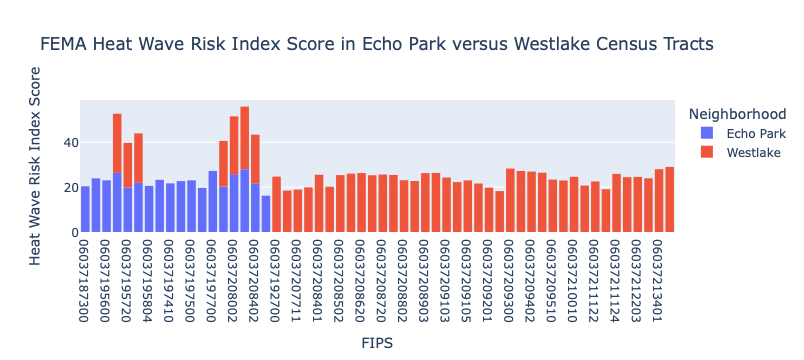

In [29]:
# subsetting for neighborhood and plotting with plotly
subset_df = NRI_transit22[NRI_transit22['Neighborhood'].isin(['Westlake', 'Echo Park'])]
fig = px.bar(subset_df,
       x= 'FIPS',
       y= 'Heat Wave Risk Index Score', 
        color='Neighborhood',
       title='FEMA Heat Wave Risk Index Score in Echo Park versus Westlake Census Tracts'
)
fig.update_traces(marker_line_width=0)
fig.show()

We can identify some slight differences in the overall Heat Wave Risk scores. That said, some census tracts are classified as both Westlake and Echo Park. Going forward, we will want to redefine these tracts. In addition, it will be useful to determine how to create an additional bar that represents the average `Heat Wave Risk Index Score` for all of L

While we will want to revise our plot for our analysis, for now, let's experiment with mapping this data. First, let's review the dataframe using `.info()` to make sure the df is appropriately structured.

In [30]:
# getting info
subset_df.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
Index: 63 entries, 804 to 2222
Data columns (total 11 columns):
 #   Column                                    Non-Null Count  Dtype   
---  ------                                    --------------  -----   
 0   FIPS                                      63 non-null     object  
 1   Heat Wave Risk Index Score                63 non-null     float64 
 2   County                                    63 non-null     object  
 3   OBJECTID                                  63 non-null     int64   
 4   Neighborhood                              63 non-null     object  
 5   geometry                                  63 non-null     geometry
 6   index_right                               63 non-null     int64   
 7   CT20                                      63 non-null     object  
 8   Total Transit Users (excluding taxicabs)  63 non-null     int64   
 9   Total Commuters                           63 non-null     int64   
 10  Percent Transit Users        

Unfortunately, the geometry column is not located in the furthest right column location. Let's move it. 

In [31]:
# moving the geometry column for mappinhg 
non_geometry_columns = [col for col in subset_df.columns if col != subset_df.geometry.name]

# reordering to put geometry column on the right
new_column_order = non_geometry_columns + [subset_df.geometry.name]

# creating new df with the reordered columns
subset_df_reordered = NRI_transit22[new_column_order]

In addition to reordering the columns, we will need to verify that our df is formatted as a `GeoDataFrame`. Let's use the `print(type())` command. 

In [32]:
# looking at df type
print(type(subset_df_reordered))

<class 'pandas.core.frame.DataFrame'>


We will need to convert our df from a pandas format into a geopandas format (from `DataFrame` to`GeoDataFrame`).

In [33]:
# converting df to gdf
gdf = gpd.GeoDataFrame(subset_df_reordered, geometry='geometry')

Let's check that this conversion was successful. 

In [34]:
# verifying conversion 
print(type(gdf))

<class 'geopandas.geodataframe.GeoDataFrame'>


Great. We can now proceed with the mapping process. Let's use `plotly` to map the broader NRI and Transit dataframe using `Heat Wave Risk Index Score` as our variable of interest. 

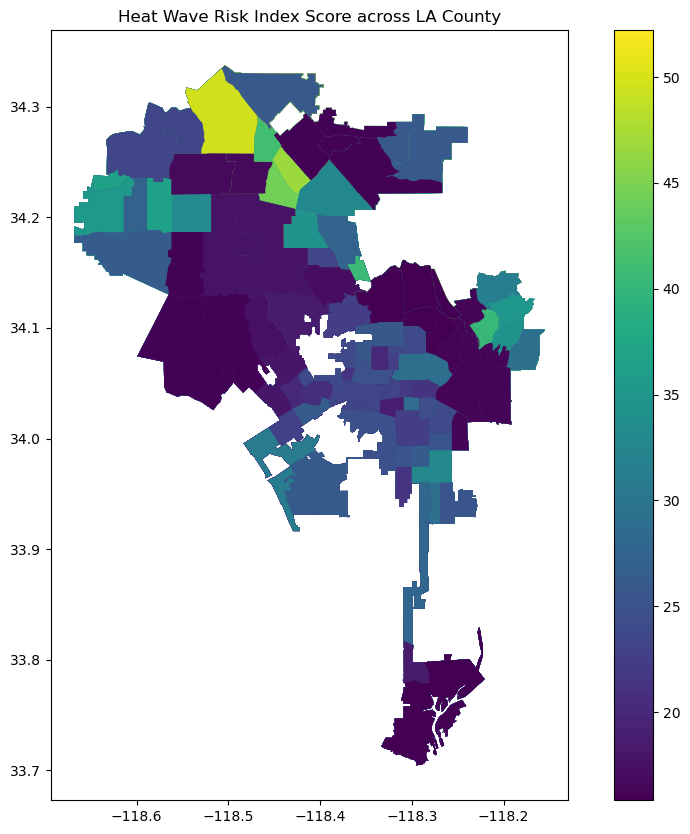

In [36]:
# producing a plotly figure 
fig, ax = plt.subplots(figsize=(12, 10))
gdf.plot(ax=ax, column='Heat Wave Risk Index Score', legend=True, cmap='viridis')

ax.set_title('Heat Wave Risk Index Score across LA County')
plt.show()
fig.savefig('heatwaveindex.png')

In the figure above, we can see some stark differences between neighborhoods on the basis of `Heat Wave Risk Index Score`, particularly between the Valley and Westside. Let's narrow in on our neighborhoods of interest. We will want to subset our `GeoDataFrame` just as we did with our `DataFrame`.

In [37]:
# subsetting gdf by neighborhood
subset_gdf = gdf[gdf['Neighborhood'].isin(['Westlake', 'Echo Park'])]

Now, let's produce a `folium` map that focuses solely on our two neighborhoods of interest, so that we can compare them on the basis of their `Heat Wave Risk Index Score`. 

In [38]:
# folium map for HWRI
m = folium.Map(location=[34.1,-118.2], 
               zoom_start = 12,
               tiles='CartoDB positron', 
               attribution='CartoDB')

# plot chorpleth over base map
folium.Choropleth(
                  geo_data=subset_gdf, 
                  data=subset_gdf,          
                  key_on='feature.properties.FIPS', 
                  columns=['FIPS', 'Heat Wave Risk Index Score'], 
                  fill_color='RdPu',
                  line_weight=0.1, 
                  fill_opacity=0.8,
                  line_opacity=0.2, 
                  hover_data={'Neighborhood': True, 'Heat Wave Index': ':.2f'},
                    legend_name='Heat Wave Risk Index Score').add_to(m)   

m


That offers us a focused visual of just our neighborhoods of interest. However, what if we want to allow for a broader view of all of LA County while also allowing for viewers to interact with our map and be able to click on individual neighborhoods for specific info on `Heat Wave Risk Index` and `Percent Transit Users`? Well, we can use `branca` and `folium` to create a `GeoJsonPopup` on our map. 

In [39]:
# creating a popup tool using branca
import branca.colormap as cm

colormap = cm.LinearColormap(
    ["#ffefef","#e7bdbd","#d66b6b","#bd3131","#9c0808"],
    vmin=gdf["Heat Wave Risk Index Score"].quantile(0.0),
    vmax=gdf["Heat Wave Risk Index Score"].quantile(1),
    caption="Heat Wave Risk Index Score",
)
gdf_json = gdf.to_json()

In [40]:
# creating the folium map we will overlay with our colormap
m = folium.Map(location=[34.2,-118.2], 
               zoom_start = 9,
               tiles='CartoDB positron', 
               attribution='CartoDB')
# creating GeoJson popups 
popup = folium.GeoJsonPopup(
    fields=["Neighborhood", "Heat Wave Risk Index Score"],
    aliases=["Neighborhood", "Heat Wave Risk Index Score"],
    localize=True,
    labels=True,
    style="background-color: green;",
)
#creating the tooltip
tooltip = folium.GeoJsonTooltip(
    fields=["Neighborhood", "Heat Wave Risk Index Score", "Percent Transit Users"],
    aliases=["Neighborhood:", "Heat Wave Risk Index Score:", "% Transit Users:"],
    localize=True,
    sticky=False,
    labels=True,
    style="""
        background-color: #F0EFEF;
        border: 2px solid black;
        border-radius: 3px;
        box-shadow: 3px;
    """,
    max_width=800,
)
#creating the choropleth graduated color map 
g = folium.GeoJson(
    gdf_json,
    style_function=lambda x: {
        "fillColor": colormap(x["properties"]["Heat Wave Risk Index Score"])
        if x["properties"]["Heat Wave Risk Index Score"] is not None
        else "transparent",
        "color": "red",
        "weight": .5,
        "fillOpacity": 0.4,
    },
    tooltip=tooltip,
    popup=popup,
).add_to(m)
#adding the color map
colormap.add_to(m)

m


In [38]:
m.save("heat_map.html")

### Closing Remarks
Now, we can ascertain differences between all neighborhoods in regards to their Heat Wave Risk Index Score as well as their particular percentage of commuters who rely on public transportation. This kind of visual will be critical as we move forward with our analysis of heat risks and shade cover in relation to neighborhoods with high public transit use. As we proceed, we will want to resolve some of the lingering issues with `plotly`. I spent hours trying to resolve some of these issues and came out empty-handed. A key issue is the fact that the dataframe has a geometry column in polygon format which limits my ability to use to `mapbox.scatter` command. 